In [33]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
from __future__ import print_function
import numpy as np
from tqdm import tqdm
import matplotlib.colors as colors
import matplotlib.pyplot as plt
from matplotlib.dates import DateFormatter
from matplotlib import cm
plt.rcParams.update({'font.size': 14, 'lines.markersize' : 4})

from scipy.optimize import curve_fit
import sys, os
import time, datetime
from datetime import timedelta
import pandas as pd
sys.path.append('/reg/d/psdm/tmo/tmox51020/results/paris/recon')
from recon_funcs import *
import h5py

/reg/neh/home/tdd14/modules/CPBASEX/pbasex-Python/pbasex/gData.py:55: SyntaxWarning: "is not" with a literal. Did you mean "!="?
  if gData['rBF'] is not 'custom':


Hi! I imported. 


In [3]:
from matplotlib import cm
from matplotlib.colors import ListedColormap
my_cmap = cm.get_cmap('jet')
xr = np.linspace(0, 1, 2000)
my_cmap = my_cmap(xr)
my_cmap[0][-1] = 0
my_cmap = ListedColormap(my_cmap)

In [4]:
def make_MM(x0):
    xshift, yshift =  x0[8], x0[9] 

    # Coordinates that you want to Perspective Transform
    pts1 = np.float32([[0,0],\
                       [0,1024],\
                       [1024,0],\
                       [1024, 1024]])


    # Size of the Transformed Image
    pts2 = np.float32([[0+xshift-x0[0],0 + yshift-x0[1]],\
                       [0+xshift-x0[2],1024 + yshift-x0[3]],\
                       [1024+xshift-x0[4],0 + yshift-x0[5]],\
                       [1024+xshift-x0[6],1024 + yshift-x0[7]]])

    MM = cv2.getPerspectiveTransform(pts1,pts2)
    return MM

X,Y=np.meshgrid(np.arange(1024),np.arange(1024))
rs=np.sqrt((X-512)**2+(Y-512)**2)
maskhm=np.zeros((1024,1024))
maskhm[(rs>120) & (rs<420)]=1
X,Y=np.meshgrid(np.arange(1024),np.arange(1024))
rs=np.sqrt((X-512)**2+(Y-512)**2)
maskhmb=np.zeros((1024,1024))
maskhmb[(rs>120) & (rs<450)]=1
nmask = np.reshape(rebin(rebin(maskhm,4),4),[64**2,])


x,y, = 530,512
X,Y=np.meshgrid(np.arange(1024),np.arange(1024))
rs=np.sqrt((X-x)**2+(Y-y)**2)
mask=np.zeros((1024,1024))
mask[rs>1*48]=1
x,y, = 530,512

nmask = np.reshape(rebin(rebin(maskhm,4),4),[64**2,]) #rebin later
nnmask = (rebin(np.reshape(nmask, [64,64]))).flatten()
nnmask = rebin(rebin(maskhm,4),4)
#nnmask = (rebin(np.reshape(nmask, [64,64])*(inbg))).flatten()
nnmask[nnmask<0.5] = 0
nnmask[nnmask>=0.5] = 1

maskscale = np.zeros((1024,1024))
X,Y=np.meshgrid(np.arange(1024),np.arange(1024))
rs=np.sqrt((X-512)**2+(Y-512)**2)
maskscale [(rs>120) & (rs<270)]=1

In [5]:
def make_quads(x0):
    quads=np.ones((1024,1024))
    quads[:512,:512]= x0[0]
    quads[:512,512:]= x0[1]
    quads[512:,:512]= x0[2]
    quads[512:,512:]= x0[3]
    return quads


In [6]:
PR = PolarRebin('/reg/d/psdm/tmo/tmox51020/results/paris/recon/PR_c32_r32_th32.h5') 

In [7]:
runnum = 112
thresh = 32
MM = make_MM([-17.998,-2.74, 17.9, -17.39, 17.86, 8.52, -3.85, 17.9, 11.47, 47.86])

mfn = 25 
gfn = 15 

ttun = np.array([4410466483435575404, 4410466513089700273, 4410466599455538812, 4410466641734519708,
                 4410466685413612212, 4410466736208210569, 4410466792511634812, 4410466874533222637,
                 4410467003413709612, 4410467007116755903, 4410467071350429845],dtype =np.uint64) #unstreaked

tt = np.array([4410466483043932127, 4410466483110647799, 4410466483127293949,
       4410466483185621010, 4410466483210655771, 4410466483277240371,
       4410466483302275132, 4410466483343824971, 4410466483360602193,
       4410466483502160004, 4410466483527194765, 4410466483602167976,
       4410466483635460276, 4410466483652106426, 4410466483735468248,
       4410466483743725787, 4410466487097071856, 4410466487130364156,
       4410466487188691217, 4410466487221983517, 4410466487271921967,
       4410466487280310578, 4410466487288568117, 4410466487330249028,
       4410466487446903150, 4410466487521876361, 4410466487621884333,
       4410466487696857544, 4410466487705115083, 4410466487713503694,
       4410466487796865516, 4410466487805123055, 4410466487888484877,
       4410466488038431299, 4410466491416681057, 4410466491583273629,
       4410466491608308390, 4410466491641600690, 4410466491766512351,
       4410466491874777862, 4410466491883166473, 4410466492149767017,
       4410466492166413167, 4410466492174801778, 4410466492208094078,
       4410466492216351617, 4410466492266421139, 4410466492291324828,
       4410466492333005739, 4410466495702997958, 4410466495719644108,
       4410466495736290258, 4410466495869590530, 4410466495961209891,
       4410466495977856041, 4410466496161225835, 4410466496169483374,
       4410466496277748885, 4410466496344464557, 4410466496386145468,
       4410466496486022368, 4410466496577641729, 4410466496594418951,
       4410466500047641920, 4410466500189199731, 4410466500305853853,
       4410466500322500003, 4410466500397473214, 4410466500414119364,
       4410466500422507975, 4410466500547419636, 4410466500630781458,
       4410466500764081730, 4410466500855701091, 4410466504350604971,
       4410466504442224332, 4410466504650497815, 4410466504783798087,
       4410466504875417448, 4410466504900321137, 4410466505000329109,
       4410466505083690931, 4410466505091948470, 4410466505141886920,
       4410466505166921681, 4410466508611887111, 4410466508720152622,
       4410466508770091072, 4410466508895133805, 4410466526656571103,
       4410466534437660812, 4410466607877964048, 4410466612513981171,
       4410466616300389284, 4410466624981157525, 4410466629317412876,
       4410466637939722984, 4410466668401644880, 4410466671896548760,
       4410466680352528440, 4410466680819013856, 4410466693536406748,
       4410466715393188974, 4410466715443127424, 4410466715501454485,
       4410466719904425508, 4410466723899238176, 4410466728127096944,
       4410466745605287548, 4410466775167006624, 4410466775591811129,
       4410466800900636708, 4410466830895811044, 4410466869980305192,
       4410466951271166321, 4410467041731039068, 4410467046125490408,
       4410467066956109577, 4410467067097667388, 4410467144364880000,
       4410467144531472572, 4410467153420514296, 4410467183348972960,
       4410467187576962800, 4410467217463347337, 4410467222465710832,
       4410467234782678620, 4410467238843813744, 4410467286316654396,
       4410467286616416168, 4410467312175327181, 4410467325134023712,
       4410467337551261616, 4410467342112436600, 4410467428163571153,
       4410467428171828692, 4410467501615146584, 4410467513749662082,
       4410467522414046317, 4410467522547346589, 4410467531503366129,
       4410467535639736608, 4410467543854150505, 4410467583171821825,
       4410467621498457396, 4410467625509785142, 4410467638543717028,
       4410467660217129460, 4410467685585068500, 4410467686368092910,
       4410467690562790450, 4410467716413336768, 4410467729255248105,
       4410467755055987045, 4410467755064244584], dtype =np.uint64)


print(len(tt))
print(len(np.unique(tt)))

155
155


In [21]:
old_tt = np.array([4410466482935666616, 4410466483277240371, 4410466483602167976,
       4410466487221983517, 4410466487288568117, 4410466487363541328,
       4410466487455291761, 4410466487555168661, 4410466487563557272,
       4410466487796865516, 4410466488038431299, 4410466496044571713,
       4410466496277748885, 4410466496344464557, 4410466500189199731,
       4410466500547419636, 4410466509161603277, 4410466509494919493,
       4410466521962095847, 4410466522078749969, 4410466525815219632,
       4410466526464943770, 4410466526673217253, 4410466534479341723,
       4410466534670969056, 4410466547862973831, 4410466551532727822,
       4410466551741001305, 4410466551857655427, 4410466552082575060,
       4410466573846689349, 4410466594452913173, 4410466594694478956,
       4410466594902752439, 4410466598747487613, 4410466599730396895,
       4410466603933220902, 4410466607877964048, 4410466612513981171,
       4410466616008885051, 4410466616092115801, 4410466616225416073,
       4410466616733582400, 4410466616900174972, 4410466620736521535,
       4410466620753167685, 4410466625222723308, 4410466625389315880,
       4410466628825892699, 4410466629317412876, 4410466633770191277,
       4410466634070084121, 4410466637939722984, 4410466638006438656,
       4410466641834527680, 4410466651198312359, 4410466654584819656,
       4410466668401644880, 4410466671771506027, 4410466671804929399,
       4410466671896548760, 4410466672254768665, 4410466680352528440,
       4410466680819013856, 4410466684855376363, 4410466684972030485,
       4410466685513489112, 4410466689674894352, 4410466693294840965,
       4410466706362196223, 4410466715076649980, 4410466715318215763,
       4410466715459904646, 4410466715501454485, 4410466719921071658,
       4410466727627319228, 4410466728127096944, 4410466732255078812,
       4410466732713306689, 4410466741127474386, 4410466744847297899,
       4410466745005501860, 4410466745388756526, 4410466745605287548,
       4410466749133483728, 4410466749616615294, 4410466750007996427,
       4410466753386377257, 4410466753502900307, 4410466753519546457,
       4410466753627943040, 4410466758313898613, 4410466761967006454,
       4410466762749899792, 4410466766536307905, 4410466766694642938,
       4410466771014121067, 4410466784180828937, 4410466800900636708,
       4410466814050829500, 4410466860782982013, 4410466860891247524,
       4410466860991124424, 4410466861457740912, 4410466865519007108,
       4410466869746996948, 4410466870080182092, 4410466925753018715,
       4410466930289290010, 4410466981025037018, 4410467011094660277,
       4410467020358436984, 4410467041731039068, 4410467042022543301,
       4410467066956109577, 4410467093272092735, 4410467093405393007,
       4410467105780687856, 4410467106022122567, 4410467110141715824,
       4410467118580787210, 4410467118880680054, 4410467123391785516,
       4410467136200535625, 4410467144531472572, 4410467148692746740,
       4410467149450867461, 4410467157315318992, 4410467175126563668,
       4410467183348972960, 4410467187576962800, 4410467191937990768,
       4410467192021352590, 4410467200601981787, 4410467209016018412,
       4410467209574123189, 4410467213010700008, 4410467217463347337,
       4410467226635242539, 4410467239018794927, 4410467256255026532,
       4410467264735909901, 4410467273316539098, 4410467281855618456,
       4410467286316654396, 4410467286524796807, 4410467286616416168,
       4410467295147106915, 4410467311800461126, 4410467312416892964,
       4410467324617468774, 4410467337859543071, 4410467342037463389,
       4410467342112436600, 4410467354904540559, 4410467363985340688,
       4410467397842682780, 4410467428163571153, 4410467428171828692,
       4410467428513402447, 4410467436452958261, 4410467436502896711,
       4410467453881734703, 4410467453940061764, 4410467458601244720,
       4410467462862657932, 4410467488239378799, 4410467501615146584,
       4410467505126827686, 4410467509338302448, 4410467513666300260,
       4410467513749662082, 4410467513757919621, 4410467513891219893,
       4410467514007874015, 4410467518544276382, 4410467522414046317,
       4410467530828476158, 4410467539609514515, 4410467543854150505,
       4410467561507322292, 4410467587466396265, 4410467591877624827,
       4410467604569851886, 4410467613009185416, 4410467625459846692,
       4410467625509785142, 4410467630129418259, 4410467638543717028,
       4410467660217129460, 4410467664245103356, 4410467668872994012,
       4410467672859418069, 4410467677603962847, 4410467689813058340,
       4410467694240933052, 4410467694582375735, 4410467698993604297,
       4410467702663358288, 4410467702696781660, 4410467737419461408,
       4410467742038832381, 4410467754356193385, 4410467758759033336],dtype =np.uint64)

In [34]:
#10 Aug 2023
#short list for testing 1/2 hole
#first 3 are unstreaked
tt = np.array([4410466483435575404, 4410466513089700273, 4410466599455538812,
                 4410466500189199731, 4410466526673217253, 4410466573846689349,
               4410466594902752439, 4410466616733582400, 4410466625389315880,
               4410466638006438656, 4410466651198312359, 4410466654584819656,
               4410466668401644880, 4410466684855376363, 4410466715076649980,
               4410466715459904646, 4410466745388756526, 4410466749616615294,
               4410466750007996427, 4410466753627943040, 4410466762749899792,
               4410466860991124424, 4410466861457740912, 4410466865519007108,
               4410467363985340688],dtype =np.uint64) #unstreaked first 3 timestamps


In [16]:
#more streaked if the above work

tt2 = np.array([4410466500189199731, 4410466526673217253, 4410466573846689349,
4410466594694478956, 4410466594902752439, 4410466599730396895,
4410466616092115801, 4410466616225416073, 4410466620736521535,
4410466620753167685, 4410466638006438656, 4410466641834527680,
4410466651198312359, 4410466654584819656, 4410466668401644880,
4410466671896548760, 4410466684855376363, 4410466684972030485,
4410466706362196223, 4410466715076649980, 4410466715443127424,
4410466715459904646, 4410466719921071658, 4410466732255078812,
4410466745388756526, 4410466749616615294, 4410466750007996427,
4410466753502900307, 4410466753627943040, 4410466758313898613,
4410466762749899792, 4410466766536307905, 4410466860891247524,
4410467157315318992, 4410467200601981787, 4410467209016018412,
4410467226635242539, 4410467239018794927, 4410467281855618456,
4410467286524796807, 4410467286616416168, 4410467311800461126,
4410467337859543071, 4410467363985340688, 4410467513749662082,
4410467513891219893, 4410467518544276382, 4410467530828476158,
4410467660217129460, 4410467668872994012, 4410467677603962847,
4410467689813058340, 4410467694240933052, 4410467702696781660,
4410467754356193385],dtype =np.uint64)

In [9]:
len(tt), len(old_tt), len(np.unique(np.hstack((tt,old_tt)))), len(tt)+len(old_tt)

NameError: name 'old_tt' is not defined

In [10]:
tt = np.unique(np.hstack((tt,old_tt)))
tt= np.array(tt,dtype =np.uint64)

NameError: name 'old_tt' is not defined

In [35]:
bgdat = np.load('/cds/home/p/paris/cVMI/bgdat_run_112_Jul31.npy')
bins = bgdat['bins_maxim']    
bg_im = bgdat['bg_im_maxim'] #bgdat['bg_im']

In [36]:
resid = np.load('innerring_resid112.npy')

In [37]:
cVMIs = []
detsum = []
cVMIsold = []
specs = []
unproc = []
maxim = []
gds = []
tmstmps = []

ds=ps.DataSource(exp = 'tmox51020', run= runnum, timestamps=tt)
#ds=ps.DataSource(exp = 'tmox51020', run= runnum, filter = lambda evt:evt.timestamp in tt)

run = next(ds.runs())

opal1 = run.Detector('tmo_opal1') # OPAL camera looking at the holey mirror
gmd = run.Detector("gmd") # gas intensity detector 
timing = run.Detector('timing') # this gives access to evr codes
ebeam = run.Detector("ebeam")
opalfzp = run.Detector('tmo_fzpopal') 



if hasattr(run, 'epicsinfo'):
    epics_strs = [item[0] for item in run.epicsinfo.keys()][1:] # first one is weird
    epics_detectors = [run.Detector(item) for item in epics_strs]    

for nevent, event in enumerate(run.events()):

    # fetch the information from the different events
    im_look=np.copy(opal1.raw.raw(event))  #opal1im_i=np.copy(opal1.raw.image(event)) #doesn't work since update
    im1=im_look

    ims = np.rot90(im1*mask)
    
    binvar = np.max(rebin(rebin(ims,4),4))
    idx = np.max((np.argmax(bins-binvar>0)-1, 0))
    idx = np.arange(np.max((0,idx-5)),np.min((12,idx+5)))
    idx = 0
    #idx = np.arange(idx-1,idx+1)
    #idx = np.arange(1,13)
    try:
        len(idx)
        #resid = np.mean(bg_im[idx],axis = 0)
        qqs = np.mean(bgdat['quads'][idx],axis = 0)
    except: 
        qqs = bgdat['quads'][idx]
        #resid = bg_im[idx]
    
    if 0 in [np.sum(qqss) for qqss in bgdat['quads'][idx]]: continue #need to fix this
    
    quads = make_quads(qqs)
    ims = cv2.warpPerspective(ims,MM,(1024,1024))
    ims2 = ims*quads
    ims2 = ims2
    ims2[ims2<0] = 0
    #ims2 = mf(ims2, mfn)
    ims2 = gf(ims2, gfn)
    ims2= rebin(rebin(ims2,4),4)
    resid = resid 
    resid[resid<0] = 0
    resid_scale = resid/np.mean(resid*rebin(rebin(maskscale,4),4))*np.mean(ims2*rebin(rebin(maskscale,4),4))
    ims2 = ims2 - resid_scale
    ims2 = ims2*rebin(rebin(maskhm,4),4)*250/np.max(ims2)
    ims2[ims2<thresh] = 0
    
    
    cVMIs.append(ims2)
    #cVMIsold.append(ims2old)
    '''
    fig,axs = plt.subplots(nrows = 1, ncols = 2, figsize = (8,4))
    axs[0].pcolormesh(ims2, cmap = my_cmap)
    axs[0].plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
    axs[1].pcolormesh(testim, cmap = my_cmap)
    axs[1].plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
    plt.show()
    '''
    
    opalfz= np.copy(opalfzp.raw.image(event)) #np.copy(opal1.raw.image(event)) #np.copy(opal1.raw.raw(event))
    zps_data = opalfz
    zps_pixel = 100+np.argmax(np.sum(zps_data[100:900],axis=1))
    px_2d_width = 25 #spacing to cut the 2d image slice to store. Typically 50 pixel width. 25 on either side
    px_edge_width = 5 #spacing to integrate for the line out. 

    zps_2d = zps_data[zps_pixel-px_2d_width:zps_pixel+px_2d_width][:]
    zps = zps_data[zps_pixel-px_edge_width:zps_pixel+px_edge_width][:].mean(0)#
    zps_bg = zps_data[zps_pixel-px_2d_width:zps_pixel-px_2d_width+px_edge_width][:].mean(0)#
    zps = zps-zps_bg
    spec = np.squeeze(fastsmooth1(zps,10))
    spec = np.array(np.squeeze(spec) - np.mean(np.squeeze(spec)[800:900])) 
    specs.append(spec)
    gd_i=gmd.raw.energy(event)
    gds.append(gd_i)
    tmstmps.append(event.timestamp)
    print(event.timestamp) 


4410466483435575404
4410466500189199731
4410466513089700273
4410466526673217253
4410466573846689349
4410466594902752439
4410466599455538812
4410466616733582400
4410466625389315880
4410466638006438656
4410466651198312359
4410466654584819656
4410466668401644880
4410466684855376363
4410466715076649980
4410466715459904646
4410466745388756526
4410466749616615294
4410466750007996427
4410466753627943040
4410466762749899792
4410466860991124424
4410466861457740912
4410466865519007108
4410467363985340688


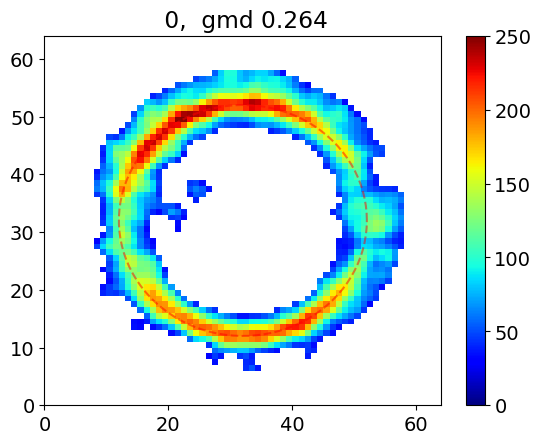

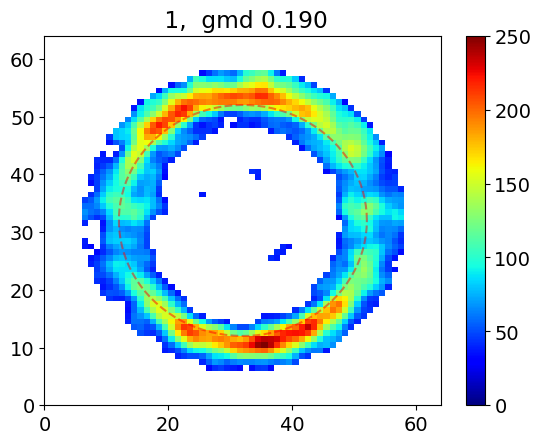

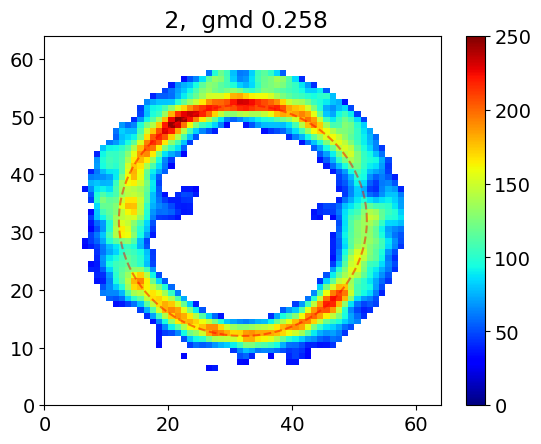

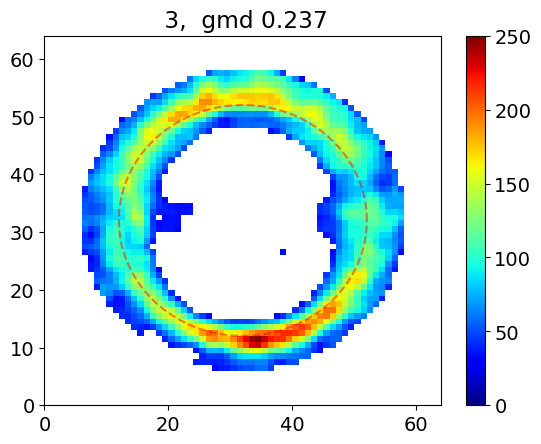

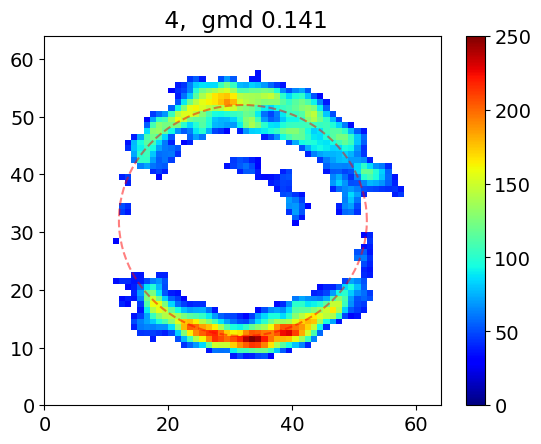

...

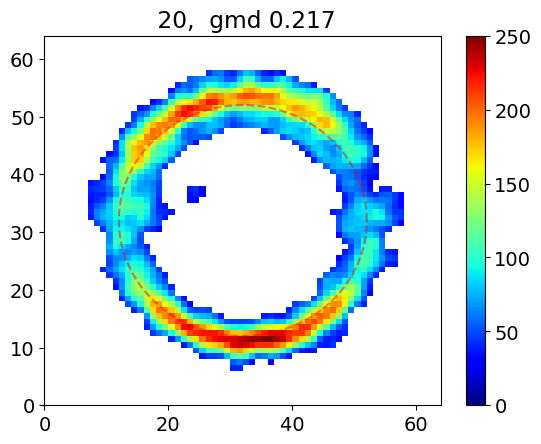

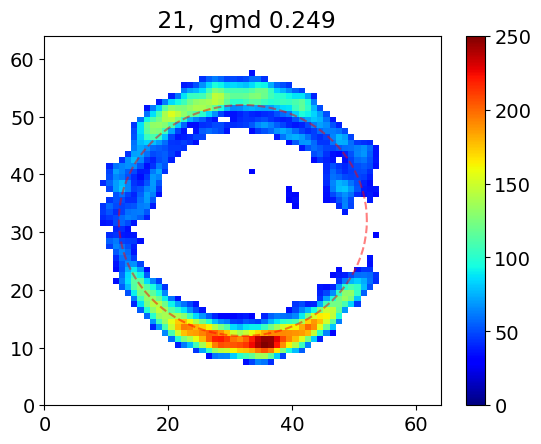

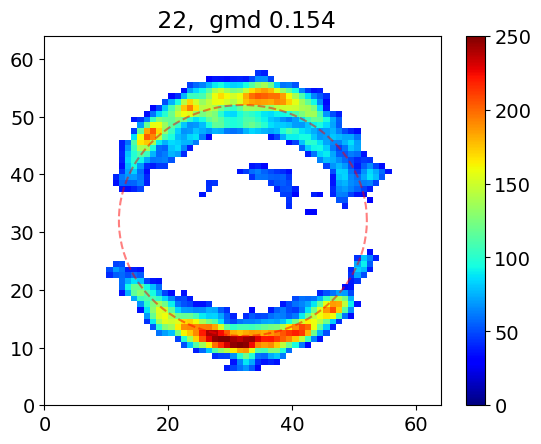

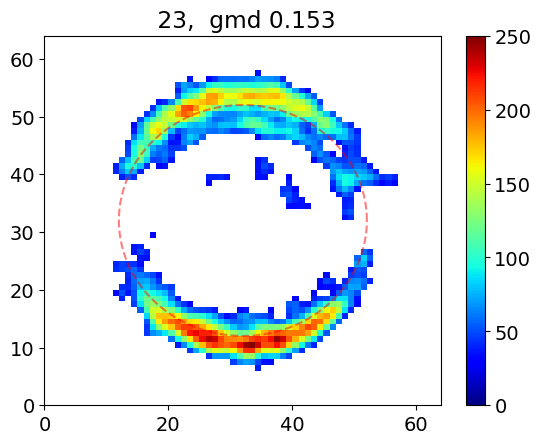

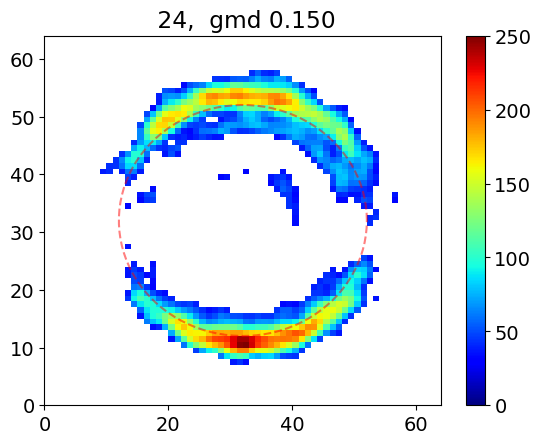

In [38]:
phi_rad = np.linspace(0,360,100)*np.pi/180

for i in range(len(specs)):
    c = cVMIs[i]
    c[c<0] = 0
    cVMIs[i] = c
    plt.pcolormesh(c, cmap = my_cmap)
    plt.plot((512+320*np.cos(phi_rad))/16, (512+320*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
    plt.colorbar()
    plt.title(' %1.0f,  gmd %1.3f' %(i, gds[i]))
    plt.show()
    # fig,axs = plt.subplots(nrows = 1, ncols = 3, figsize = (15,4))
    # scc = 1 #np.max(cVMIsa[i]/np.sum(cVMIsa[i]))
    # p = axs[0].pcolormesh(cVMIsa[i]/np.sum(cVMIsa[i])/scc, cmap = my_cmap)
    # plt.colorbar(p, ax = axs[0])
    # p = axs[1].pcolormesh(cVMIsb[i]/np.sum(cVMIsb[i])/scc, cmap = my_cmap)
    # plt.colorbar(p, ax = axs[1])
    # p = axs[2].pcolormesh(cVMIsa[i]/np.sum(cVMIsa[i])/scc-cVMIsb[i]/np.sum(cVMIsb[i])/scc, cmap = my_cmap)
    # plt.colorbar(p, ax = axs[2])
    # plt.show()

In [20]:
# cut = np.array([0,1,3,4,5,7,12,13,15,16,17,18,19,20,21,22,23,24,26,28,29,30,31,33,34,35,37,38,39,\
#        41,42,43,45,47,50,51,52,54,56,58,59,60,62,63,64,65,66.67,68,69,70,71,72,73,74,75,\
#        76,78,79,80,81,82,85,86,87,88,89,91,94,95,96,97,98,99,101,102,103,104,105,107,108,\
#        109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,126,127,128,130,131,\
#        132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,\
#        153,154,155,156,157,158,159,160,161,162,163,164,165,166,168,169,170,171,172,173,174,\
#        175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,\
#        196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,214,215,216,217,\
#        218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,\
#        239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,\
#        260,261,262,263,264,266,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,\
#        283,285,286,287,289,290,291,292,293,294,296,297,298,299,300,301,302,303,304,305,306,\
#        307,308,309,310,311,312,313,314,315,316,317,318], dtype = int)
specs = np.array(specs)
cVMIs = np.array(cVMIs)
gds = np.array(gds)
tmstmps = np.array(tmstmps)

In [21]:
np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/specs_Aug10_112.npy', specs)
np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/Ms_Aug10_112.npy', cVMIs)
np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/GDs_Aug10_112.npy', gds)
np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/tmstmps_Aug10_112.npy', tmstmps)


In [22]:
len(tt)

25

In [41]:
np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/specs_Aug9_112.npy', specs[cut])
np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/Ms_Aug9_112.npy', cVMIs[cut])
np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/GDs_Aug9_112.npy', gds[cut])
np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/tmstmps_Aug9_112.npy', tmstmps[cut])


In [43]:
mdatname='/cds/home/p/paris/reconVMI_clean/recon X510 Dec/Ms_Aug9_112.npy'
specdatname ='/cds/home/p/paris/reconVMI_clean/recon X510 Dec/specs_Aug9_112.npy'

cVMIs = np.load(mdatname,allow_pickle = True)[()]
specs = np.load(specdatname,allow_pickle = True)[()]
gds = np.load('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/GDs_Aug9_112.npy',allow_pickle = True)[()]
                                                                                                       

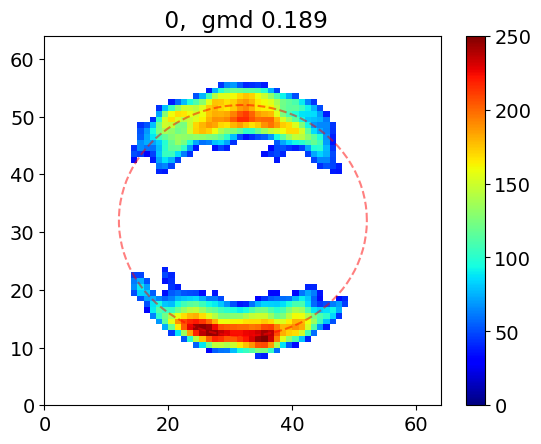

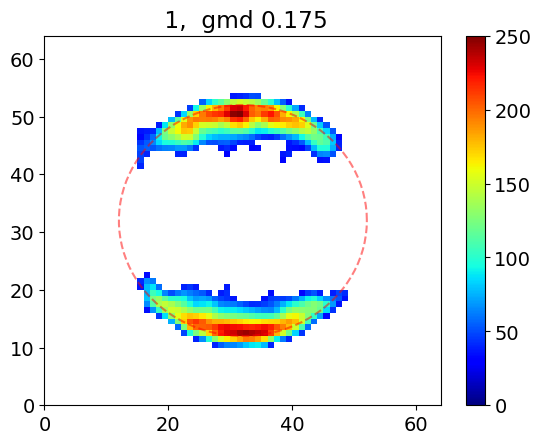

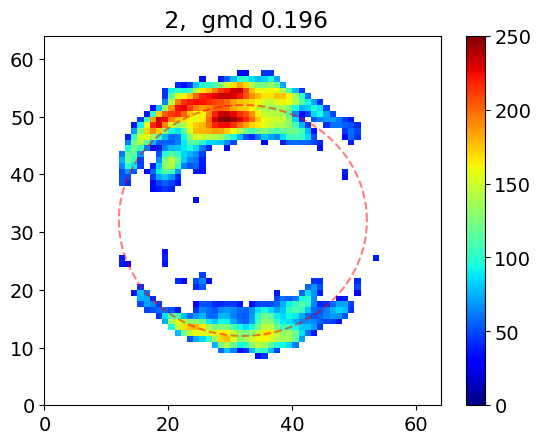

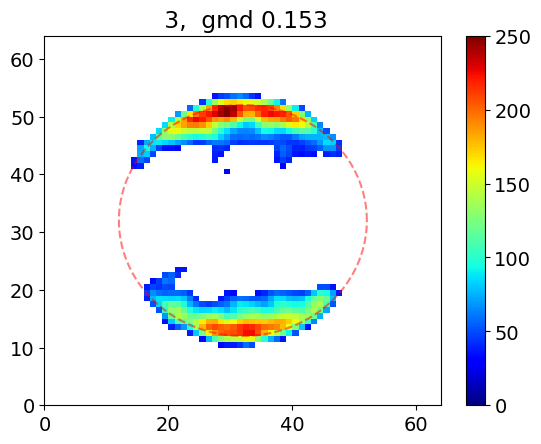

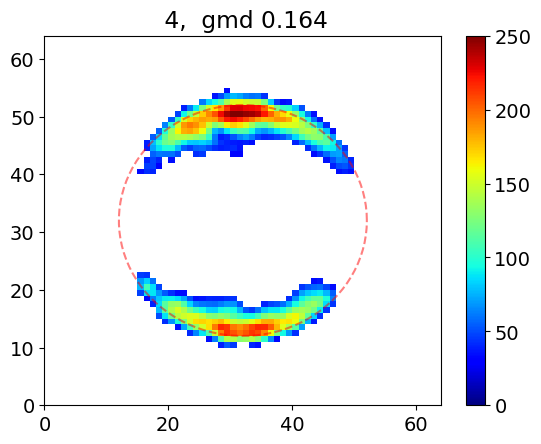

...

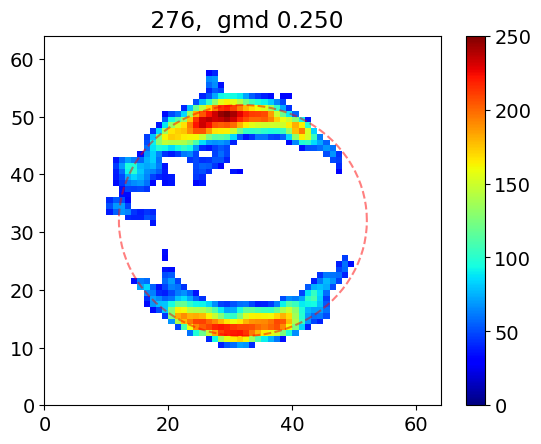

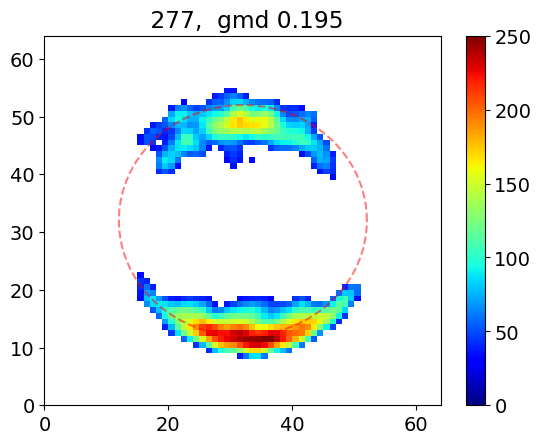

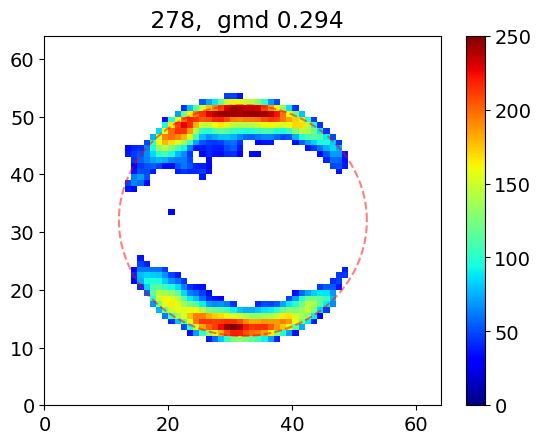

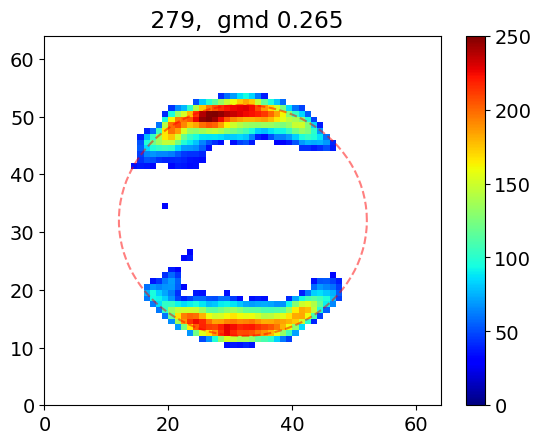

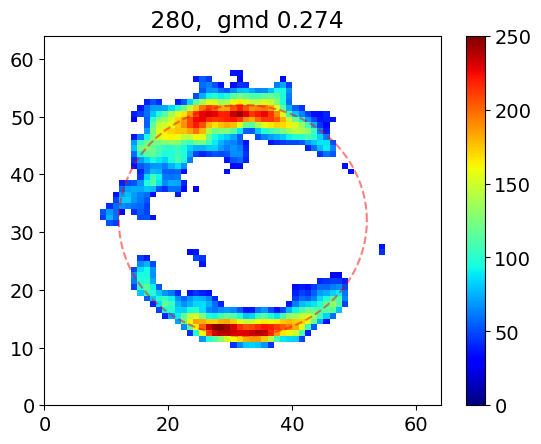

In [44]:
phi_rad = np.linspace(0,360,100)*np.pi/180

for i in range(len(specs)):
    c = cVMIs[i]
    c[c<0] = 0
    cVMIs[i] = c
    plt.pcolormesh(c, cmap = my_cmap)
    plt.plot((512+320*np.cos(phi_rad))/16, (512+320*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
    plt.colorbar()
    plt.title(' %1.0f,  gmd %1.3f' %(i, gds[i]))
    plt.show()
    # fig,axs = plt.subplots(nrows = 1, ncols = 3, figsize = (15,4))
    # scc = 1 #np.max(cVMIsa[i]/np.sum(cVMIsa[i]))
    # p = axs[0].pcolormesh(cVMIsa[i]/np.sum(cVMIsa[i])/scc, cmap = my_cmap)
    # plt.colorbar(p, ax = axs[0])
    # p = axs[1].pcolormesh(cVMIsb[i]/np.sum(cVMIsb[i])/scc, cmap = my_cmap)
    # plt.colorbar(p, ax = axs[1])
    # p = axs[2].pcolormesh(cVMIsa[i]/np.sum(cVMIsa[i])/scc-cVMIsb[i]/np.sum(cVMIsb[i])/scc, cmap = my_cmap)
    # plt.colorbar(p, ax = axs[2])
    # plt.show()

In [18]:
cVMIs = np.load('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/Ms_Aug1_127.npy')

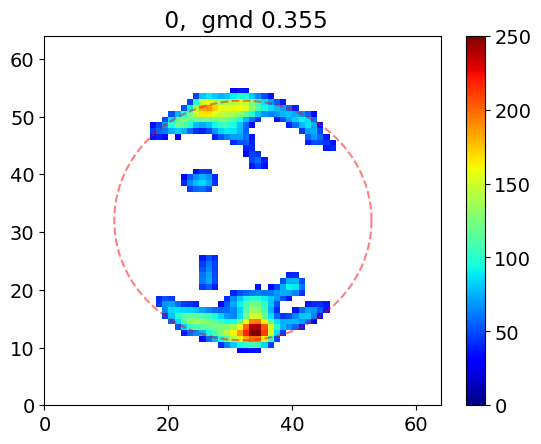

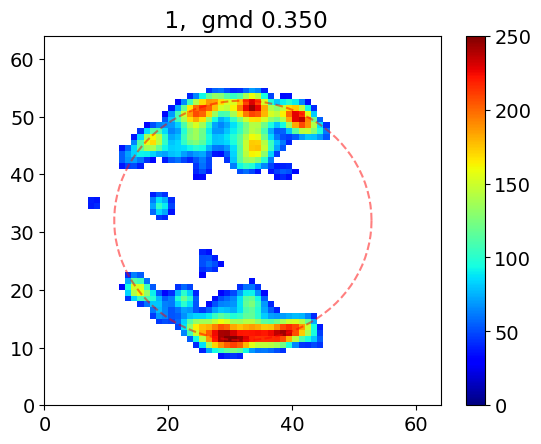

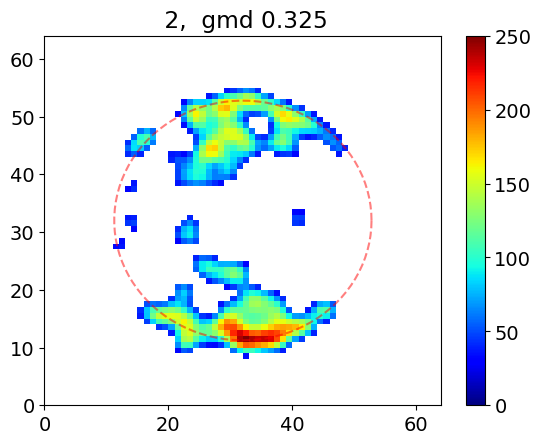

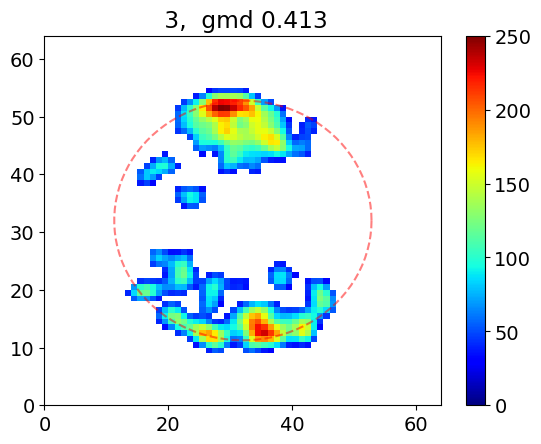

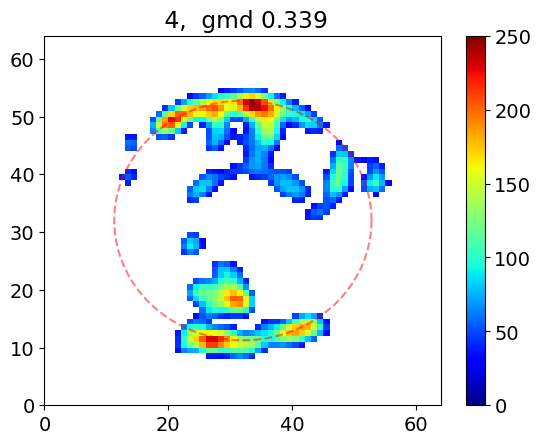

...

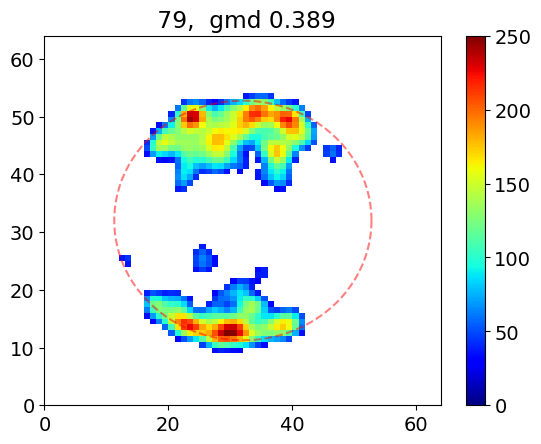

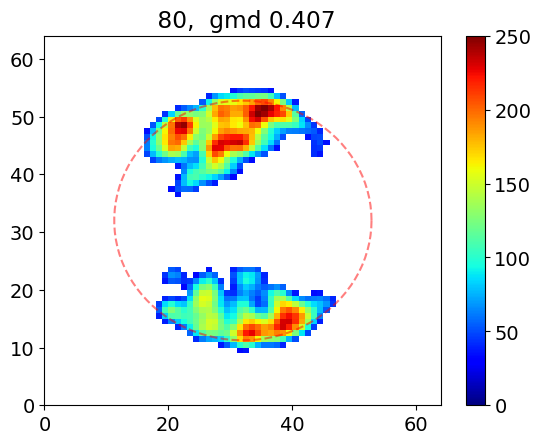

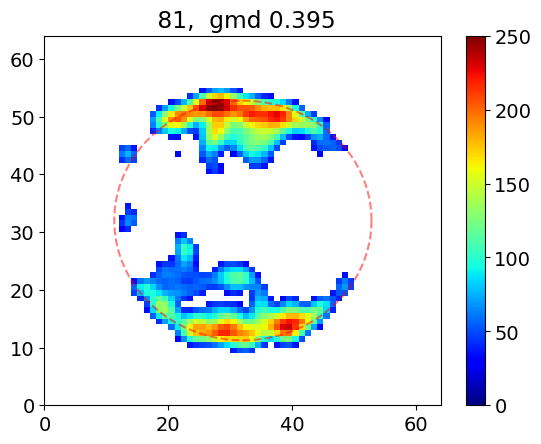

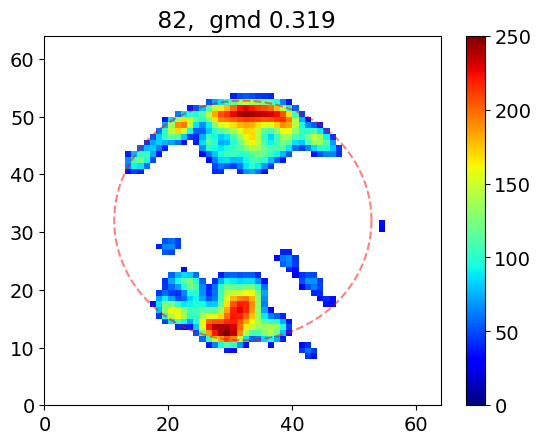

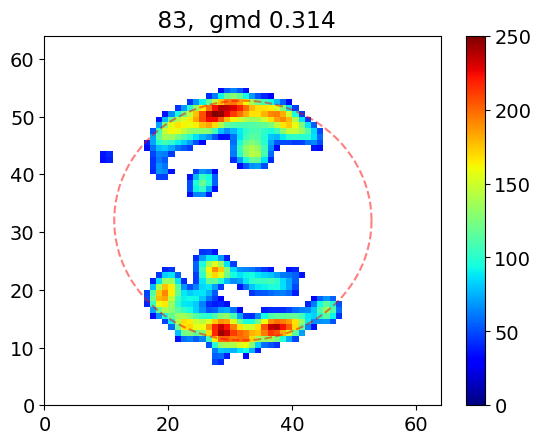

In [19]:
phi_rad = np.linspace(0,360,100)*np.pi/180

for i in range(len(specs)):
    c = cVMIs[i]
    c = gf(c,1)
    c = c*250/np.max(c)
    c[c<32] = 0
    plt.pcolormesh(c, cmap = my_cmap)
    plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
    plt.colorbar()
    plt.title(' %1.0f,  gmd %1.3f' %(i, gds[i]))
    plt.show()
    # fig,axs = plt.subplots(nrows = 1, ncols = 3, figsize = (15,4))
    # scc = 1 #np.max(cVMIsa[i]/np.sum(cVMIsa[i]))
    # p = axs[0].pcolormesh(cVMIsa[i]/np.sum(cVMIsa[i])/scc, cmap = my_cmap)
    # plt.colorbar(p, ax = axs[0])
    # p = axs[1].pcolormesh(cVMIsb[i]/np.sum(cVMIsb[i])/scc, cmap = my_cmap)
    # plt.colorbar(p, ax = axs[1])
    # p = axs[2].pcolormesh(cVMIsa[i]/np.sum(cVMIsa[i])/scc-cVMIsb[i]/np.sum(cVMIsb[i])/scc, cmap = my_cmap)
    # plt.colorbar(p, ax = axs[2])
    # plt.show()

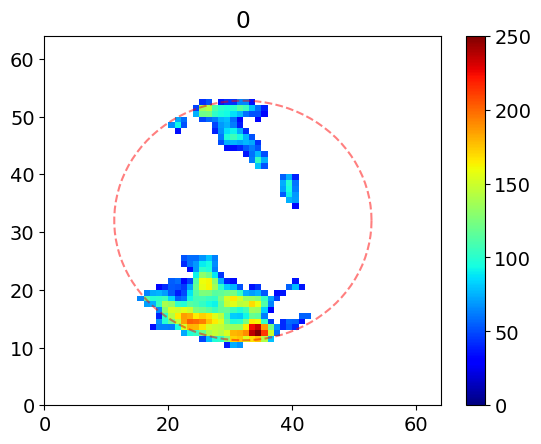

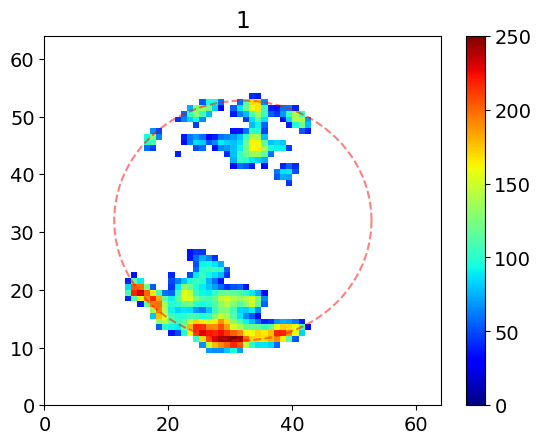

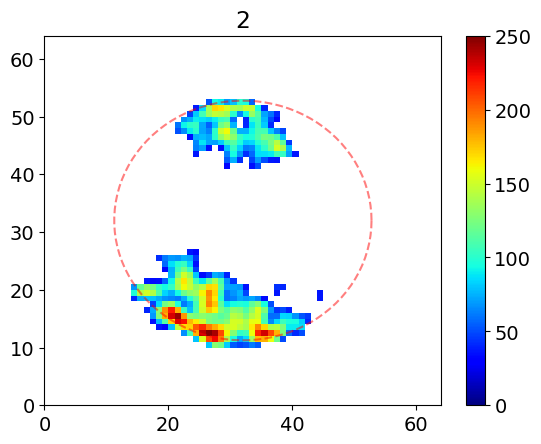

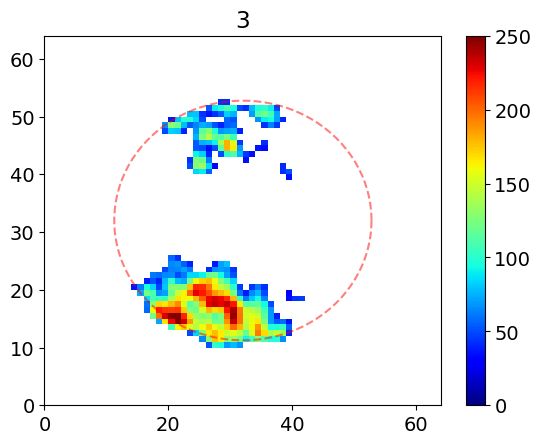

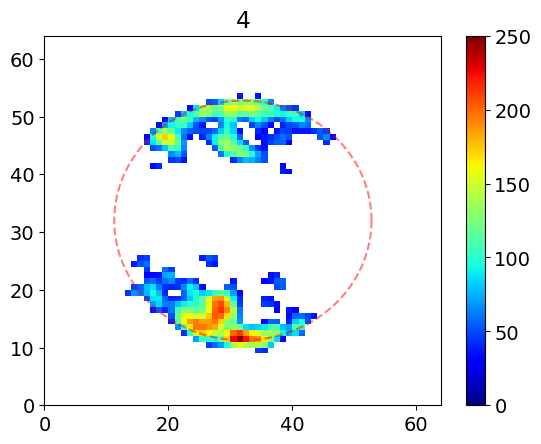

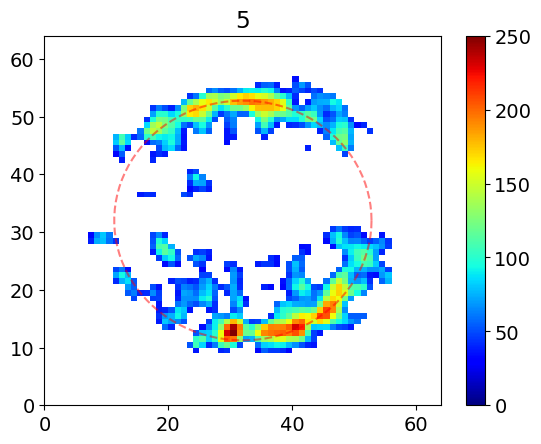

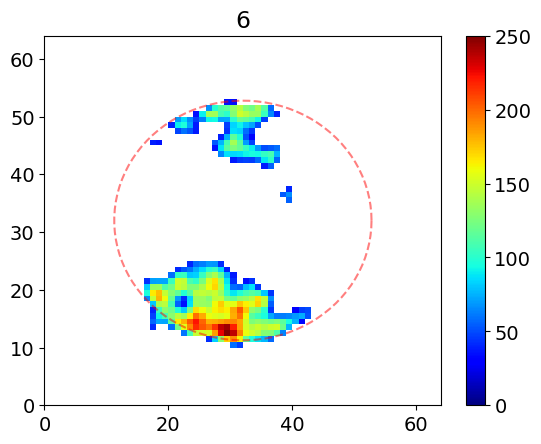

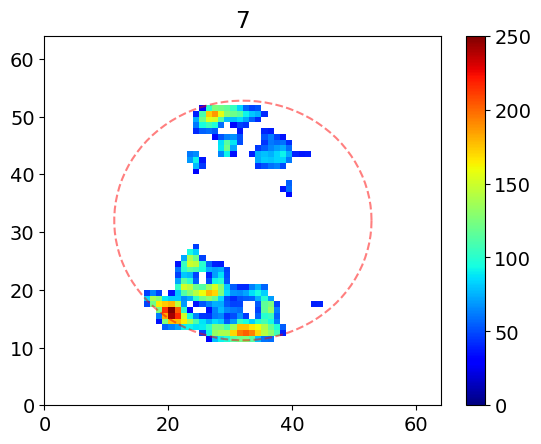

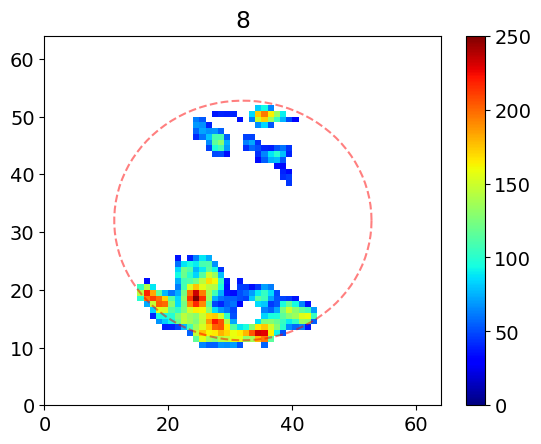

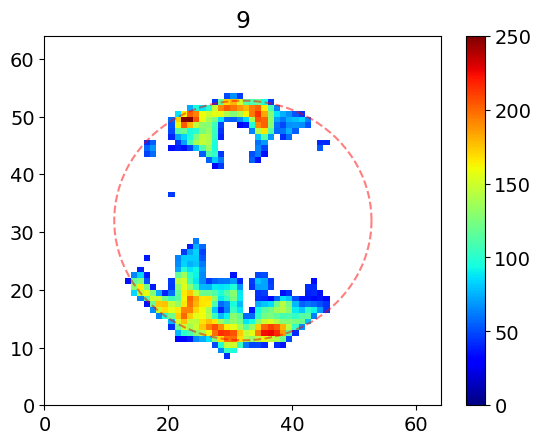

In [11]:
cVMIs2 = np.load('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/Ms_Mar25_127.npy', allow_pickle = True)[()]
phi_rad = np.linspace(0,360,100)*np.pi/180

for i in range(10):
    c = cVMIs2[i]
    c[c<0] = 0
    plt.pcolormesh(c, cmap = my_cmap)
    plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
    plt.colorbar()
    plt.title(i)
    plt.show()

Text(0.5, 1.0, '5')

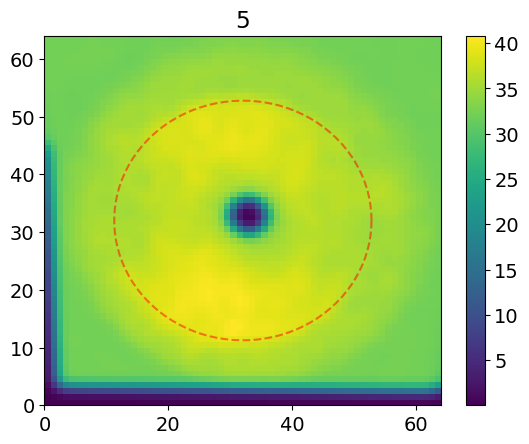

In [34]:
i = 5
plt.pcolormesh(unproc[i])
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.colorbar()
plt.title(i)

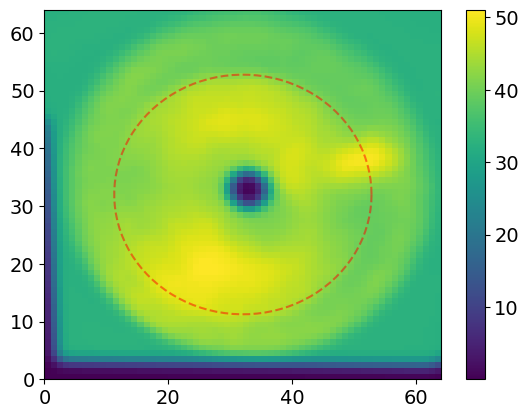

In [28]:
plt.pcolormesh(resid)
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)

plt.colorbar()

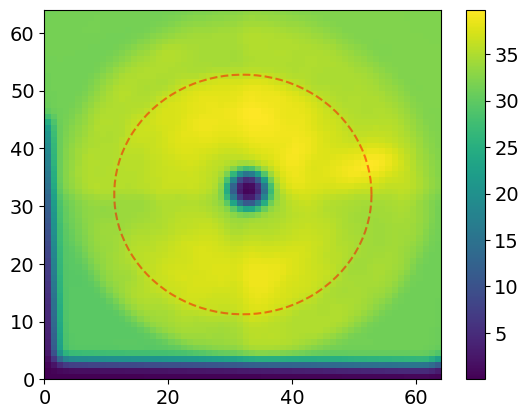

In [29]:
resid2= np.load('/cds/home/p/paris/reconVMI_clean/recon X510 Jan/bg_run_127_Mar.npy')
plt.pcolormesh(resid2)
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)

plt.colorbar()

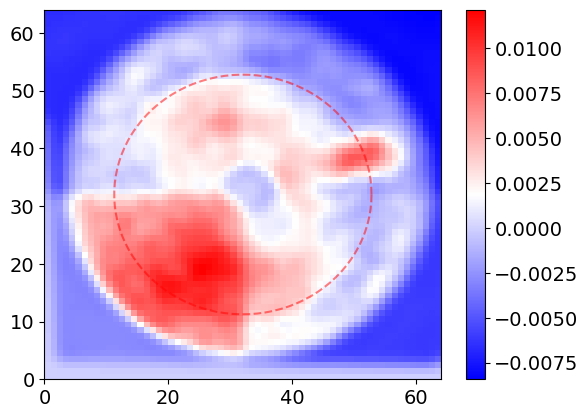

In [33]:
plt.pcolormesh((resid/np.sum(resid)-resid2/np.sum(resid2))*250, cmap = 'bwr')
plt.colorbar()
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)


In [15]:
len(cVMIs2)

115

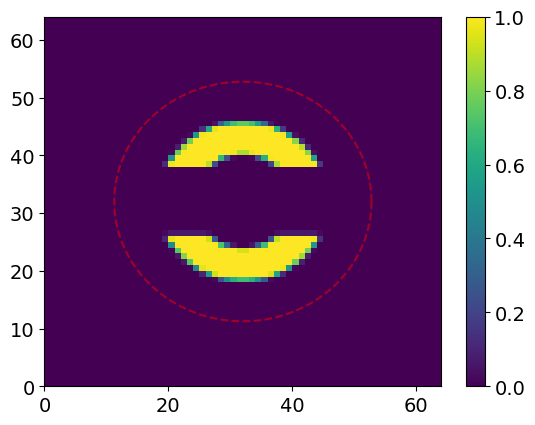

In [42]:
# testmask = np.zeros((1024,1024))
# X,Y=np.meshgrid(np.arange(1024),np.arange(1024))
# rs=np.sqrt((X-512)**2+(Y-512)**2)
# testmask [(rs>100) & (rs<220)] = 1

testmask = np.zeros((1024,1024))
X,Y=np.meshgrid(np.arange(1024),np.arange(1024))
rs=np.sqrt((X-512)**2+(Y-512)**2)
testmask [(rs>130) & (rs<220)]=1
testmask [(Y>26*16) & (Y<38*16)]=0

# testmask = np.zeros((1024,1024))
# X,Y=np.meshgrid(np.arange(1024),np.arange(1024))
# rs=np.sqrt((X-512)**2+(Y-512)**2)
# testmask [(rs>140) & (rs<220) & (X>28*16) &(X<36*16)]=1

# testmask = np.zeros((1024,1024))
# X,Y=np.meshgrid(np.arange(1024),np.arange(1024))
# rs=np.sqrt((X-512)**2+(Y-512)**2)
# #testmask[(Y>26*16) & (Y<38*16) & (rs>80)]=1
# testmask[(Y>28*16) & (Y<36*16) & (rs>80)]=1
# testmask [(rs>390) & (rs<430)]=1


# testmask = np.zeros((1024,1024))
# X,Y=np.meshgrid(np.arange(1024),np.arange(1024))
# rs=np.sqrt((X-512)**2+(Y-512)**2)
# testmask [(rs>390) & (rs<430)]=1

plt.pcolormesh(rebin(rebin(testmask,4),4))
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.colorbar()


In [43]:
ims2 = np.copy(ims)
ims2 = mf(ims2, mfn)
ims2 = gf(ims2, gfn)
ims2= rebin(rebin(ims2,4),4)
unproc = ims2

#resid_scale = resid/np.mean(resid[24:36,22:27])*np.mean(ims2[24:36,22:27])
resid_scale = resid/np.mean(resid*rebin(rebin(testmask,4),4))*np.mean(ims2*rebin(rebin(testmask,4),4))
#residold_scale = residold/np.mean(residold*rebin(rebin(maskscale,4),4))*np.mean(ims2*rebin(rebin(maskscale,4),4))
#ims2old = ims2 - residold_scale
ims2 = ims2 - resid_scale
ims2 = gf(ims2,.25)
#ims2old = gf(ims2old,.25)
#ims2 = rebin(ims2) #*inbg
ims2 = ims2*250/np.max(ims2)#*rebin(rebin(maskhm,4),4)



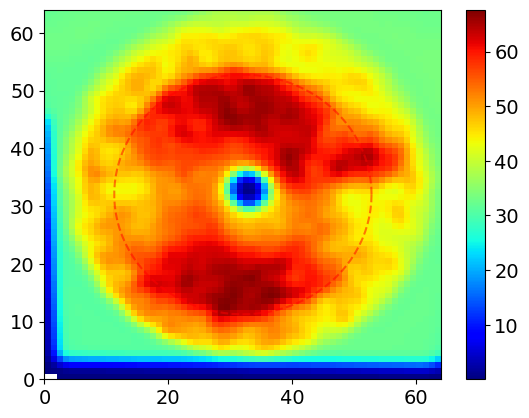

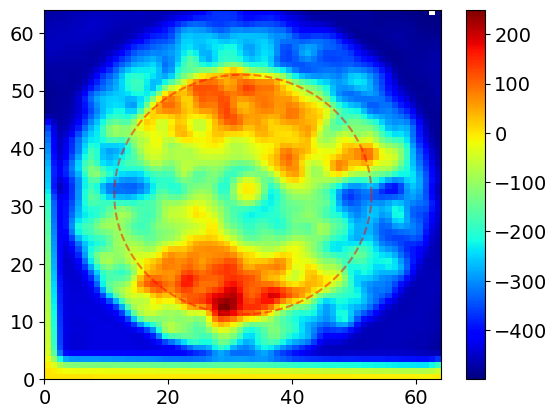

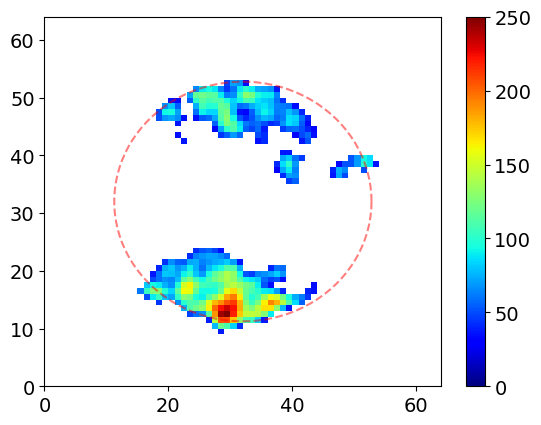

In [44]:
plt.pcolormesh(unproc, cmap = my_cmap)
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.colorbar()
plt.show()
plt.pcolormesh(ims2, cmap = my_cmap)
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.colorbar()
plt.show()
ims2[ims2<thresh] = 0
plt.pcolormesh(ims2*rebin(rebin(maskhm,4),4), cmap = my_cmap)
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.colorbar()
plt.show()

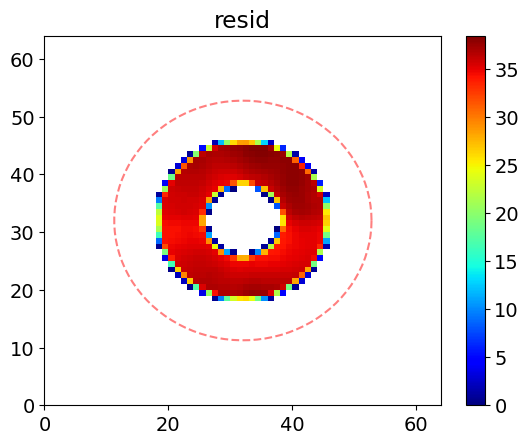

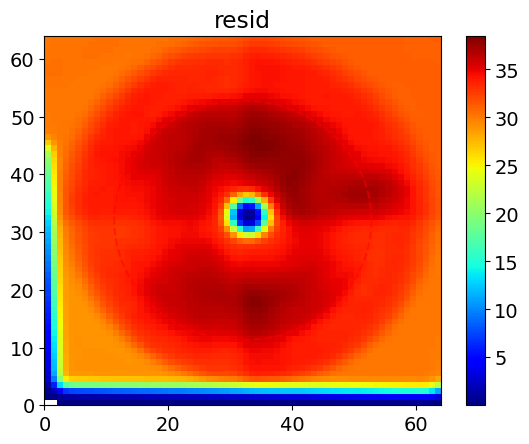

In [57]:
plt.pcolormesh(resid*rebin(rebin(testmask,4),4), cmap = my_cmap)
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.colorbar()
plt.title('resid')
plt.show()


plt.pcolormesh(resid, cmap = my_cmap)
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.colorbar()
plt.title('resid')
plt.show()

In [250]:
maskscale = np.zeros((1024,1024))
X,Y=np.meshgrid(np.arange(1024),np.arange(1024))
rs=np.sqrt((X-512)**2+(Y-512)**2)
maskscale [(rs>100) & (rs<220)]=1
#maskscale [(rs>120) & (rs<250)]=1



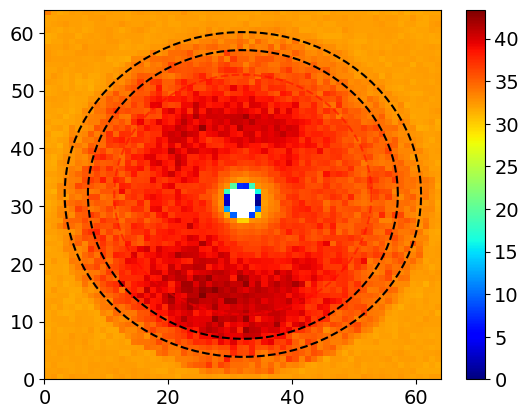

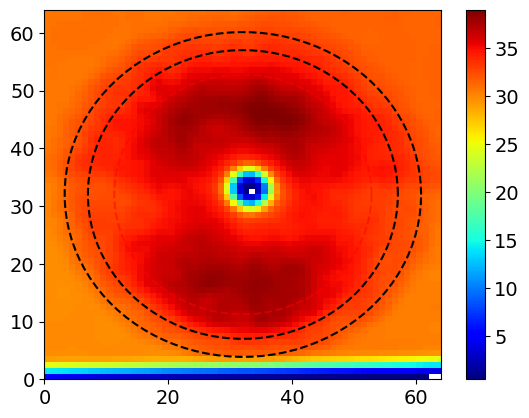

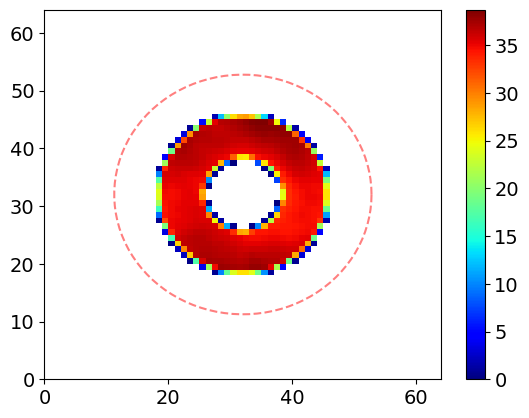

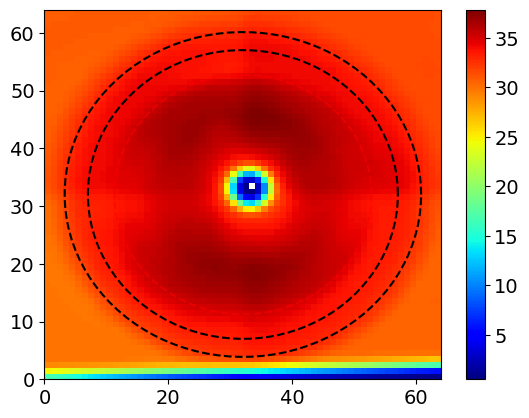

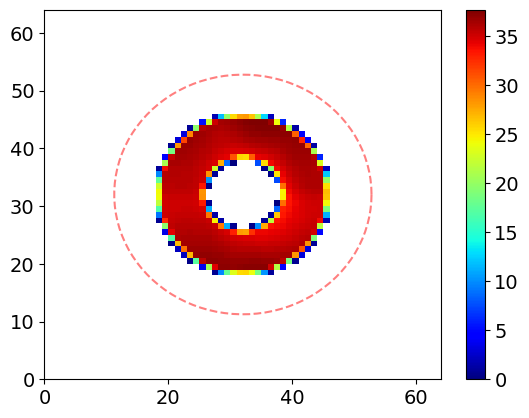

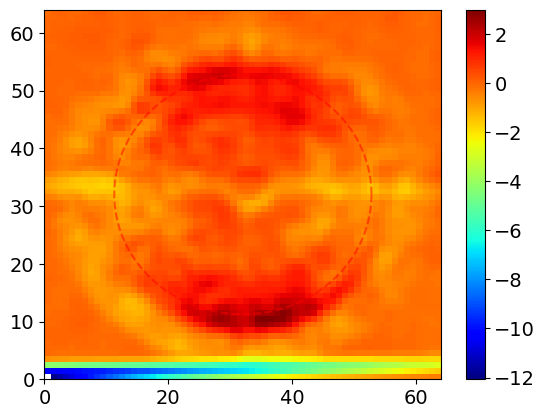

In [251]:
ims = np.rot90(im1*mask)
plt.pcolormesh(rebin(rebin(ims,4),4), cmap = my_cmap)
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.plot((512+400*np.cos(phi_rad))/16, (512+400*np.sin(phi_rad))/16, 'k--')
plt.plot((512+460*np.cos(phi_rad))/16, (512+450*np.sin(phi_rad))/16, 'k--')
plt.colorbar()
plt.show()

gasoff = 0 #gasoff0/np.mean(gasoff0)*np.mean(ims)
ims = cv2.warpPerspective(ims-gasoff,MM,(1024,1024))*quads
ims[ims<0] = 0
ims2 = np.copy(ims)
ims2 = mf(ims2, mfn)
ims2 = gf(ims2, gfn)
ims2= rebin(rebin(ims2,4),4)
plt.pcolormesh(ims2, cmap = my_cmap)
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.plot((512+400*np.cos(phi_rad))/16, (512+400*np.sin(phi_rad))/16, 'k--')
plt.plot((512+460*np.cos(phi_rad))/16, (512+450*np.sin(phi_rad))/16, 'k--')
plt.colorbar()
plt.show()

plt.pcolormesh(ims2*rebin(rebin(maskscale,4),4), cmap = my_cmap)
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.colorbar()
plt.show()

plt.pcolormesh(resid, cmap = my_cmap)
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.plot((512+400*np.cos(phi_rad))/16, (512+400*np.sin(phi_rad))/16, 'k--')
plt.plot((512+460*np.cos(phi_rad))/16, (512+450*np.sin(phi_rad))/16, 'k--')
plt.colorbar()
plt.show()

plt.pcolormesh(resid*rebin(rebin(maskscale,4),4), cmap = my_cmap)
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.colorbar()
plt.show()



plt.pcolormesh(ims2 - resid, cmap = my_cmap)
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.colorbar()
plt.show()


In [248]:
# maskscale3 = np.zeros((1024,1024))
# X,Y=np.meshgrid(np.arange(1024),np.arange(1024))
# rs=np.sqrt((X-512)**2+(Y-512)**2)
# maskscale3[(rs>400) & (rs<450)]=1



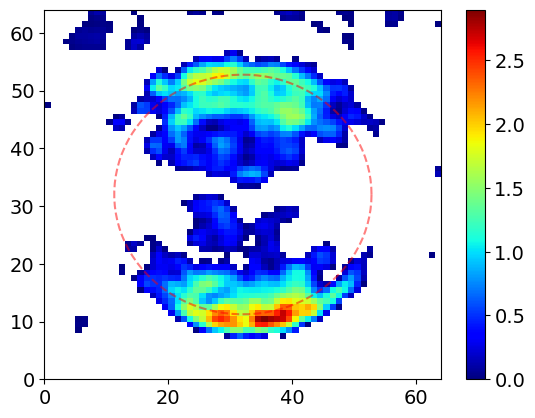

In [252]:
resid_scale = resid/np.mean(resid*rebin(rebin(maskscale,4),4))*np.mean(ims2*rebin(rebin(maskscale,4),4))
ims2 = ims2 - resid_scale
ims2 = gf(ims2,.25)
ims2[ims2<0] = 0
phi_rad = np.linspace(0,360,100)*np.pi/180
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.pcolormesh(ims2, cmap = my_cmap)
plt.colorbar()
plt.show()

In [51]:
len(specs)

42

In [52]:
len(cVMIs)

42

In [53]:
len(tt)

42

(array([7., 4., 5., 7., 4., 3., 5., 4., 2., 1.]),
 array([0.15234375, 0.16209717, 0.17185059, 0.181604  , 0.19135742,
        0.20111084, 0.21086426, 0.22061768, 0.23037109, 0.24012451,
        0.24987793]),
 <BarContainer object of 10 artists>)

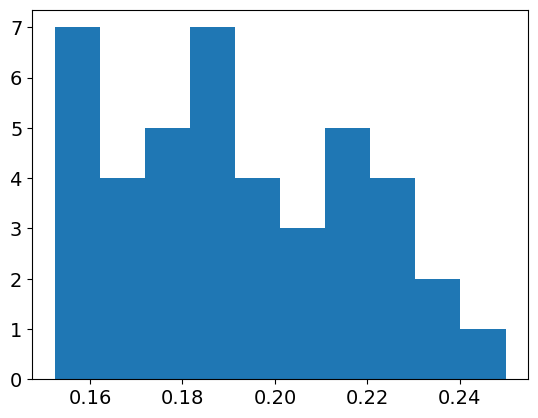

In [15]:
plt.hist(gds)

In [16]:
np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/GDs_Jan19_110_2.npy', gds)

In [60]:
np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/specs_Jan19_110_2.npy', specs)
np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/Ms_Jan19_110_2.npy', cVMIs)

In [63]:
np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/specs_Jan16_110.npy', specs)
np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/Ms_Jan16_110.npy', cVMIs)

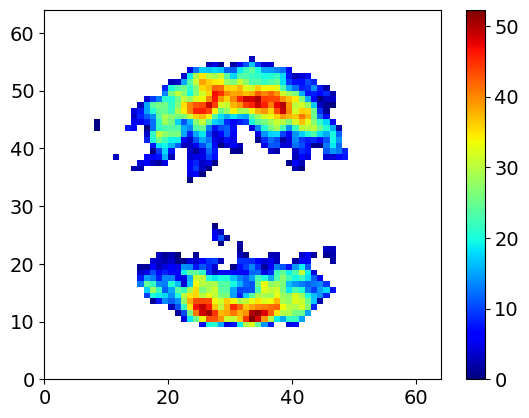

In [69]:
plt.pcolormesh(cVMIs[-10], cmap = my_cmap)
plt.colorbar()

In [9]:
np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/specs_Jan11.npy', specs)
np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/Ms_Jan11.npy', cVMIs)

In [48]:
np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/specs_Dec16.npy', specs)
np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/Ms_Dec16.npy', cVMIs)
np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/Ms_nobg_Dec16.npy', unproc)
np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/ts_Dec16.npy', tt)

In [32]:
# np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Sep/specs_Nov5.npy', specs)
# np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Sep/Ms_Nov5.npy', cVMIs)
# np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Sep/Ms_oldresid_Nov5.npy', cVMIsold)
# np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Sep/ts_Nov5.npy', tt)

In [13]:
np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Sep/Ms_nobg_Nov5.npy', unproc)

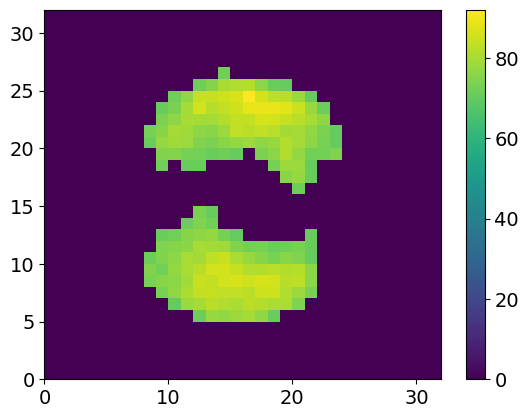

In [30]:
aa = rebin(unproc[0])
aa[ aa<70] = 0
plt.pcolormesh(aa)
plt.colorbar()

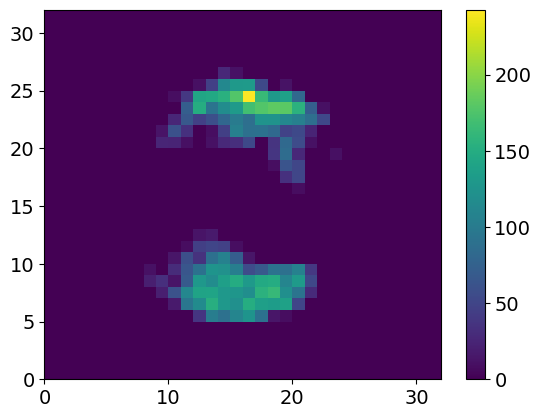

In [28]:
bb = rebin(cVMIs[0])
bb[bb<0] = 0
plt.pcolormesh(bb)
plt.colorbar()

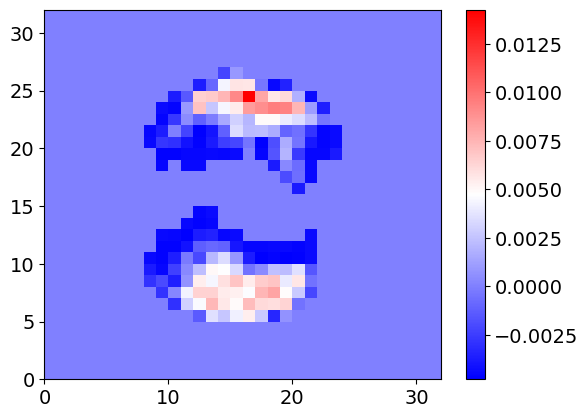

In [33]:
plt.pcolormesh(bb/np.sum(bb) - aa/np.sum(aa), cmap = 'bwr')
plt.colorbar()


/tmp/ipykernel_15835/1804110446.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig,axs = plt.subplots(nrows = 1, ncols = 5, figsize = (16,3))


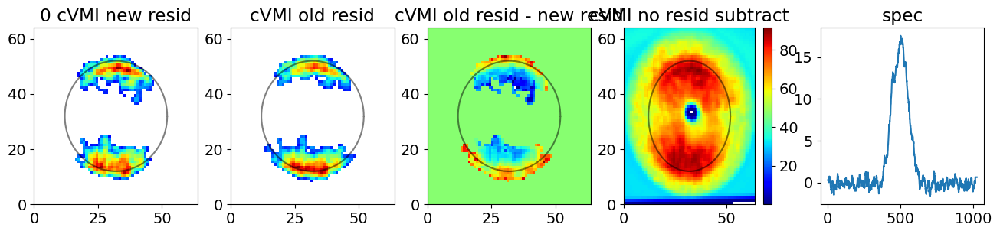

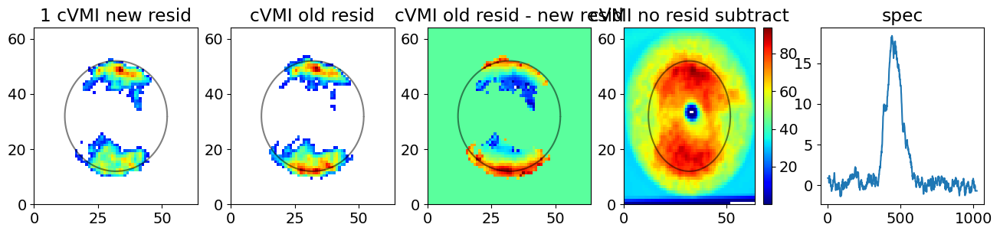

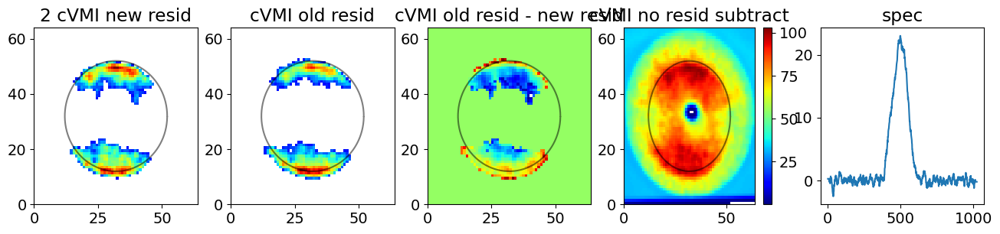

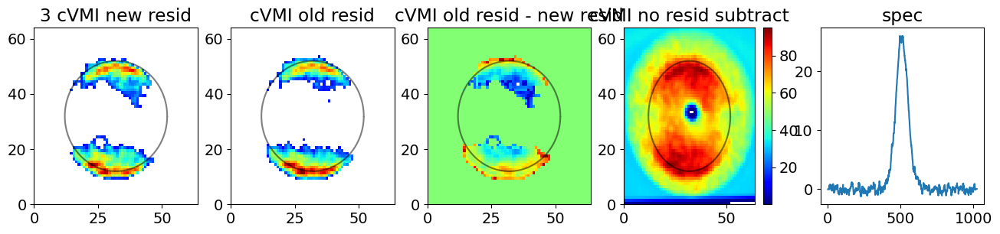

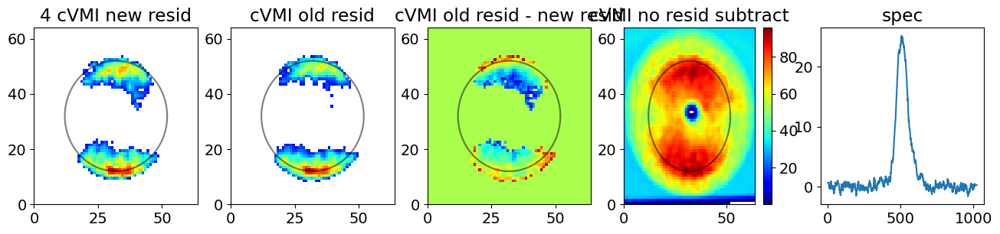

...

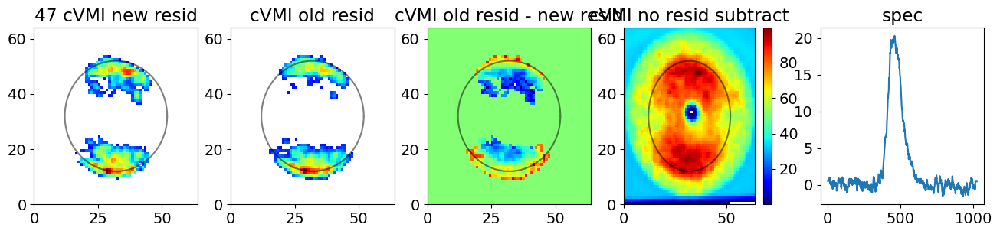

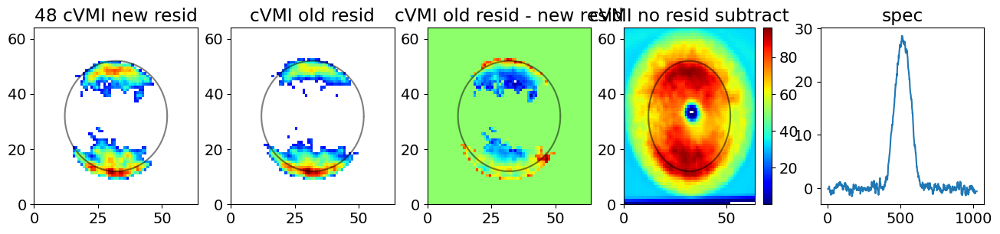

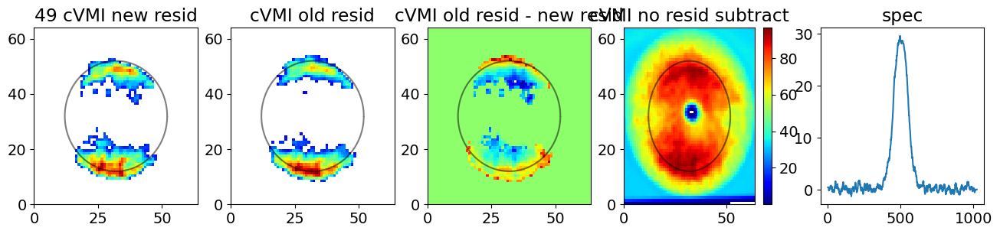

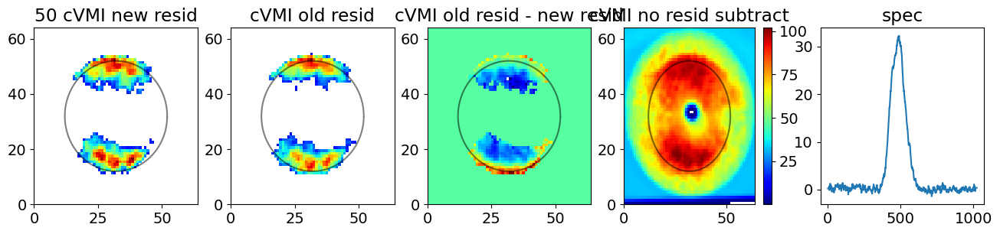

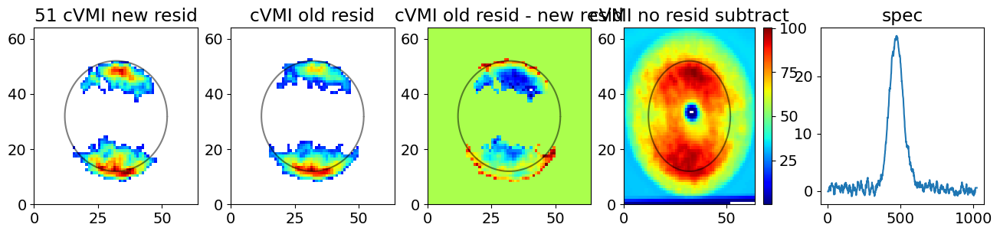

In [49]:
for i in range(len(tt)):
    fig,axs = plt.subplots(nrows = 1, ncols = 5, figsize = (16,3))
    axs[0].pcolormesh(cVMIs[i], cmap = my_cmap)
    axs[1].pcolormesh(cVMIsold[i], cmap = my_cmap)
    axs[2].pcolormesh(cVMIsold[i]-cVMIs[i], cmap = my_cmap)
    p =axs[3].pcolormesh(unproc[i], cmap = my_cmap)
    phis = np.linspace(0,359,100)*np.pi/180
    axs[0].plot(32+ 20*np.cos(phis), 32+ 20*np.sin(phis), 'k-', alpha = 0.5)
    axs[1].plot(32+ 20*np.cos(phis), 32+ 20*np.sin(phis), 'k-', alpha = 0.5)
    axs[2].plot(32+ 20*np.cos(phis), 32+ 20*np.sin(phis), 'k-', alpha = 0.5)
    axs[3].plot(32+ 20*np.cos(phis), 32+ 20*np.sin(phis), 'k-', alpha = 0.5)
    axs[4].plot(specs[i])
    axs[0].set_title('%1.0f cVMI new resid' %i)
    axs[1].set_title('cVMI old resid')
    axs[2].set_title('cVMI old resid - new resid')
    axs[3].set_title('cVMI no resid subtract')
    axs[4].set_title('spec')
    plt.colorbar(p, ax = axs[3])

In [9]:
# np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Sep/specs_testOct28.npy', specs)
# np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Sep/Ms_testOct28.npy', cVMIs)


In [48]:
b = np.load('/cds/home/p/paris/reconVMI_clean/recon X510 Sep/specs_testOct28.npy', allow_pickle = True)[()]

In [49]:
len(b)

17

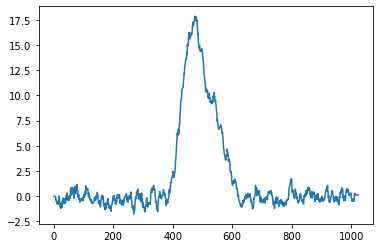

In [52]:
plt.plot(b[12])

In [97]:
tt[10]

4410467694582375735

In [105]:
tt = [4410467754356193385,4410467118580787210,4410467689813058340,4410467428163571153,4410466620736521535,4410467136200535625,4410467724635877132,4410466707012051433,4410467488239378799,
      4410467689813058340, 4410467694582375735,4410466861291017268,4410467028356057715,4410467093272092735,4410467354904540559,4410467518544276382,4410467530828476158, 4410467668872994012] #[4410466500172553581]#[4410466517201035991] #[4410466517376017174] #[4410466521487221820] #[4410466500172553581] #[4410467694582375735] #[4410467436627939444]
tt= np.array(tt)
tt= tt[np.argsort(tt)]
tt[16]

4410467724635877132

In [106]:
ttnew = [4410467754356193385,4410467118580787210,4410467428163571153,4410466620736521535,4410467136200535625,4410467724635877132,4410466707012051433,4410467488239378799,
      4410467689813058340, 4410467694582375735,4410466861291017268,4410467028356057715,4410467093272092735,4410467354904540559,4410467518544276382,4410467530828476158, 4410467668872994012,
      4410466482935666616, 4410466573846689349, 4410466594694478956, 4410466654584819656, 4410466684855376363, 4410466684972030485,4410466732255078812, 4410466753627943040, 4410466771014121067,
      4410466861457740912, 4410466865519007108, 4410466869746996948, 4410466925753018715, 4410466930289290010, 4410466981025037018]

ttnew= np.array(ttnew)
ttnew= ttnew[np.argsort(ttnew)]
np.where(np.array(ttnew) == 4410467724635877132)

(array([30]),)

In [99]:
ttnew[9]

4410467694582375735

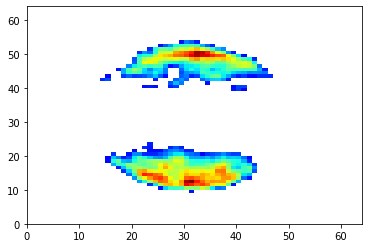

In [42]:
plt.pcolormesh(b, cmap = my_cmap)

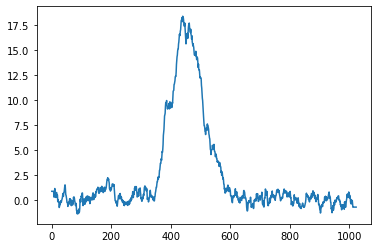

In [62]:
c = np.load('/cds/home/p/paris/reconVMI_clean/recon X510 Sep/specs_Oct31.npy', allow_pickle = True)[()][0]
plt.plot(c)

In [24]:
np.load('/cds/home/p/paris/reconVMI_clean/recon X510 Sep/specs_test.npy', allow_pickle = True)[()].shape

(17, 1024)

In [65]:
from scipy.interpolate import interp1d

In [70]:
Bps = []
alphas = []
vNaxiss = []

Np = 128
N_w=6
N_t=6 
energy_x = 54 #eV
hbar=6.6e-16 #eV*s
Nb=N_t*N_w
basesdir = '/reg/d/psdm/tmo/tmox51020/results/paris/circularpol_vNbases_dipole_K5/'

Up = 0.7  
filename = 'Bpbasis_Np' + str(Np) + '_Nw' + str(N_w) +'_Nt' + str(N_t) + '_Up' + str(Up)+'.npy'
br = np.load(basesdir+filename, allow_pickle=True)
Breal = br[()]['Breal']
Bimag = br[()]['Bimag']
breal = br[()]['breal']
bimag = br[()]['bimag']
vNaxis = br[()]['vNaxis']
alpha = br[()]['alpha']
Bp_basis = Breal+1j*Bimag

In [71]:
N = 2801
xf = np.arange(-N/2,N/2,1)/((vNaxis['t_sample'][-1] - vNaxis['t_sample'][0])) #using tsample range
eV = 1239.84*(2*np.pi*xf)/2.9979E8/(2*np.pi)*1e-9 

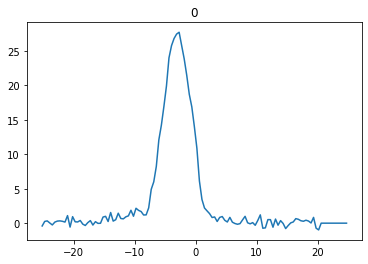

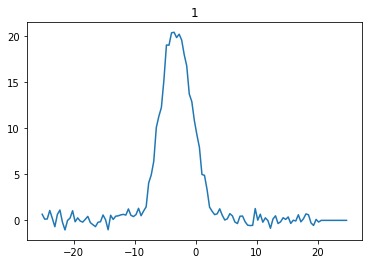

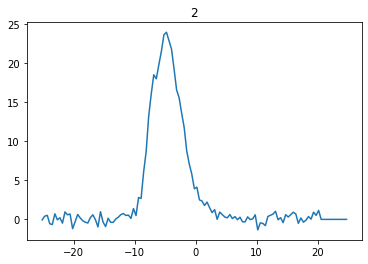

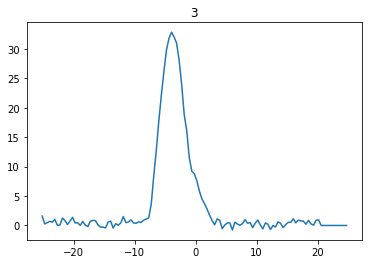

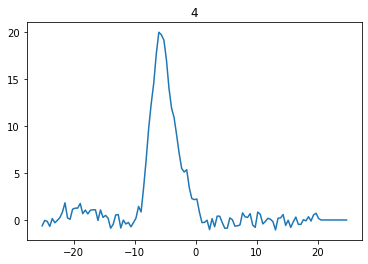

...

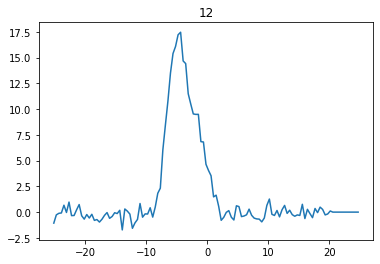

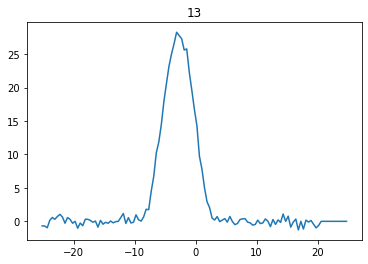

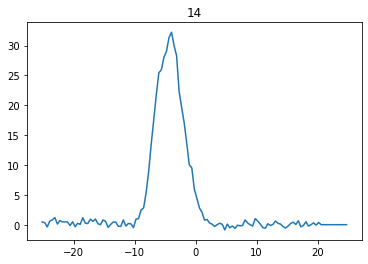

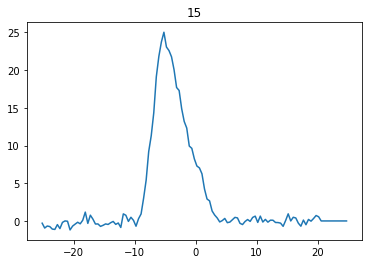

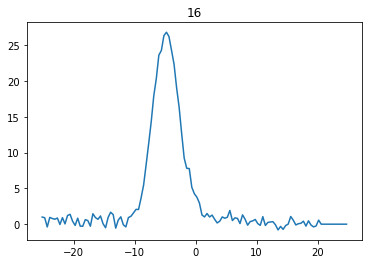

In [93]:
for i in range(17):
    fig,axs = plt.subplots()
    c = np.load('/cds/home/p/paris/reconVMI_clean/recon X510 Sep/specs_testOct28.npy', allow_pickle = True)[()][i]
    eshift = 2.9
    xeV = pix_2_eV(np.arange(1024), pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = 512)
    xeV = xeV - eshift #2.5 #3 #know this from previous calibration
    f = interp1d(xeV,c, bounds_error=False, fill_value = 0)
    spec_in = f(eV[1340:-1340])
    #plt.plot(eV[1340:-1340], spec_in, ':')
    plt.plot(eV[1340:-1340], spec_in)
    plt.title(i)
    

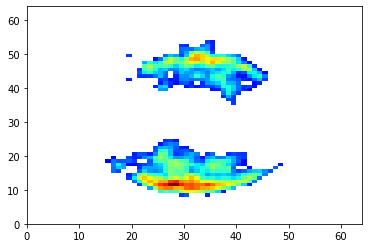

In [94]:
m = np.load('/cds/home/p/paris/reconVMI_clean/recon X510 Sep/Ms_testOct28.npy', allow_pickle = True)[()][10]
plt.pcolormesh(m, cmap = my_cmap)
   

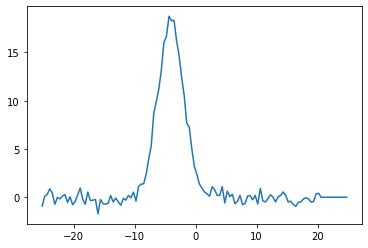

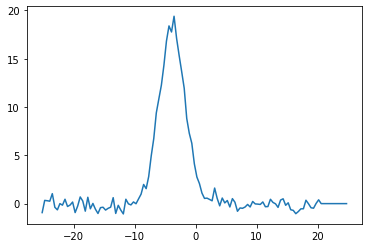

In [96]:
c = np.load('/cds/home/p/paris/reconVMI_clean/recon X510 Sep/specs_testOct28.npy', allow_pickle = True)[()][10]
eshift = 2.9
xeV = pix_2_eV(np.arange(1024), pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = 512)
xeV = xeV - eshift #2.5 #3 #know this from previous calibration
f = interp1d(xeV,c, bounds_error=False, fill_value = 0)
spec_in = f(eV[1340:-1340])
plt.plot(eV[1340:-1340], spec_in)
eshift = 2.7
xeV = pix_2_eV(np.arange(1024), pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = 512)
xeV = xeV - eshift #2.5 #3 #know this from previous calibration
f = interp1d(xeV,c, bounds_error=False, fill_value = 0)
spec_in = f(eV[1340:-1340])
#plt.plot(eV[1340:-1340], spec_in, ':')
fig,axs = plt.subplots()
plt.plot(eV[1340:-1340], spec_in)

In [6]:
! cp torchrecon_funcs.py /reg/d/psdm/tmo/tmox51020/results/paris/recon

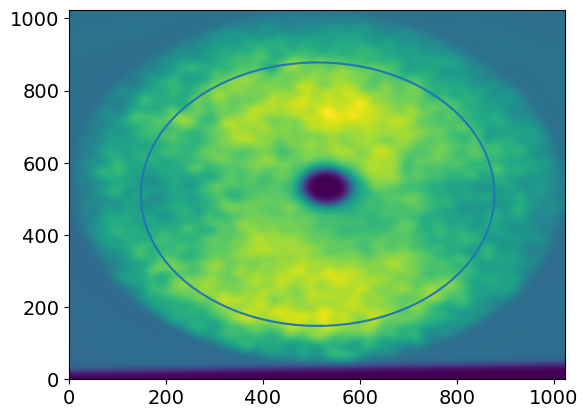

In [45]:
plt.pcolormesh(iiii)
phis = np.linspace(0,360,100)*np.pi/180
plt.plot(512+5.6*np.cos(347)+365*np.cos(phis), 512+5.6*np.cos(347)+365*np.sin(phis),)

In [42]:
R_vs_phi_1st, phi_1st = center_optimization_1st_polar(iiii, [512,512])
fit = lstSqFit(circpol, phi_1st, R_vs_phi_1st, [5,300,100], return_resid=True) # phi_1st, R_vs_phi_1st, [5,300,100], return_resid=True)

In [43]:
fit

(array([  5.60305325, 365.42739272, 347.05100458]), 19114.872376537853)

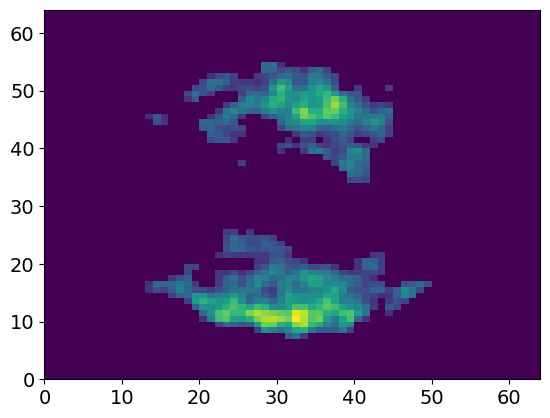

In [13]:
mdat = np.load('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/Ms_Dec16.npy')
plt.pcolormesh(mdat[16])

In [24]:
R_vs_phi_1st, phi_1st = center_optimization_1st_polar(gf(cv2.resize(mdat[16], (1024,1024), interpolation = cv2.INTER_AREA),7), [512,512])
fit = lstSqFit(circpol, phi_1st, R_vs_phi_1st, [5,300,100], return_resid=True) # phi_1st, R_vs_phi_1st, [5,300,100], return_resid=True)

In [25]:
fit

(array([ 17.53019695, 336.63918593, 228.24245851]), 35502.88634779221)

In [27]:
17.5/16

1.09375

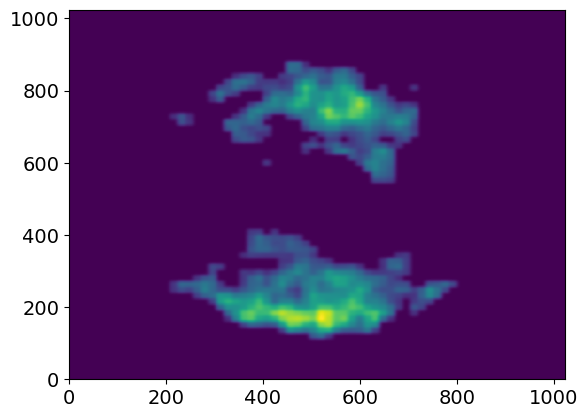

In [29]:
plt.pcolormesh(gf(cv2.resize(mdat[16], (1024,1024), interpolation = cv2.INTER_AREA),4))

In [45]:
a = [2,10,49,74,82,84,85,86,87,92,93,94,96,97,100,105,106,107,108,109,111,112,115,116,117,122,123,124,126,127,128,129,130,134,135,136,137,138,141,142,143,144,145,146,147,148,149,150,151,152,153,155,157,160,161,162,163,164,167,168,170,171,174,175,176,178,179,181,182,183,184,185,187,188,189,191,192,193,195,196,197,198,200,201,203,206,209,210,211,212,213,215,217,221,224,225,226,227,228,229,230,231,232,236,237,238,239,240,241,242,243,246,250,253,254,255,259,260,261,263,266,268,269,271,272,277,280]